# Análise sobre a Precificação de Aluguel Temporário de Imóveis  

## Analisando e Limpando os Dados

In [5]:
import pandas as pd
import numpy as np
import matplotlib 
import matplotlib.pyplot as plt 
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import scipy.stats as stats
import geopandas as gpd
import folium 
!pip install mapclassify

from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.preprocessing import LabelEncoder,MinMaxScaler
from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor  
from sklearn.inspection import permutation_importance
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score

from time import time

from warnings import simplefilter
simplefilter("ignore")

from IPython.display import display, HTML

!pip install jupyter
!pip install nbConvert

In [6]:
data = pd.read_csv(r"C:\Users\lost4\OneDrive\Documentos\DATA\DATA SCIENCE\lighthouse\teste_indicium_precificacao.csv", encoding='utf-8')
data.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [11]:
def create_scrollable_table(data, table_id, title):
    html = f'<h3>{title}</h3>'
    html += f'<div id="{table_id}" style="height:200px; overflow:auto;">'
    html += data.to_html()
    html += '</div>'
    return html

In [13]:
print(f'O conjunto de dados possui {data.shape[0]} linhas e {data.shape[1]} colunas.')

O conjunto de dados possui 48895 linhas e 16 colunas.


In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48895 entries, 0 to 48894
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              48895 non-null  int64  
 1   name                            48879 non-null  object 
 2   host_id                         48895 non-null  int64  
 3   host_name                       48874 non-null  object 
 4   neighbourhood_group             48895 non-null  object 
 5   neighbourhood                   48895 non-null  object 
 6   latitude                        48895 non-null  float64
 7   longitude                       48895 non-null  float64
 8   room_type                       48895 non-null  object 
 9   price                           48895 non-null  int64  
 10  minimum_nights                  48895 non-null  int64  
 11  number_of_reviews               48895 non-null  int64  
 12  last_review                     

No conjunto de dados apresentados, obtemos 4 colunas com valores vazios, sendo eles, Nome e Nome do Anfitrião. Ambos, podem ser provientes de cadastrados não finalizados. 

Os valores não preenchidos nas colunas de Ultima Review e Review por Mês podem nos atualizar da sazionalidade e periodicidade das reservas. 

In [15]:
numerical_features = data.select_dtypes(include=[np.number])
numerical_features.describe()

,id,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,1.901714e+07,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,1.098311e+07,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.539000e+03,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,9.471945e+06,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,1.967728e+07,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,2.915218e+07,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,3.648724e+07,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


In [17]:
numerical_features = data.select_dtypes(include=[np.number])
summary_stats = numerical_features.describe().T
html_numerical = create_scrollable_table(summary_stats, 'numerical_features', 'Estatísticas Numerais para as Variáveis')

display(HTML(html_numerical))

,count,mean,std,min,25%,50%,75%,max
id,48895.0,1.901714e+07,1.098311e+07,2539.00000,9.471945e+06,1.967728e+07,2.915218e+07,3.648724e+07
host_id,48895.0,6.762001e+07,7.861097e+07,2438.00000,7.822033e+06,3.079382e+07,1.074344e+08,2.743213e+08
latitude,48895.0,4.072895e+01,5.453008e-02,40.49979,4.069010e+01,4.072307e+01,4.076311e+01,4.091306e+01
longitude,48895.0,-7.395217e+01,4.615674e-02,-74.24442,-7.398307e+01,-7.395568e+01,-7.393627e+01,-7.371299e+01
price,48895.0,1.527207e+02,2.401542e+02,0.00000,6.900000e+01,1.060000e+02,1.750000e+02,1.000000e+04
minimum_nights,48895.0,7.029962e+00,2.051055e+01,1.00000,1.000000e+00,3.000000e+00,5.000000e+00,1.250000e+03
number_of_reviews,48895.0,2.327447e+01,4.455058e+01,0.00000,1.000000e+00,5.000000e+00,2.400000e+01,6.290000e+02
reviews_per_month,38843.0,1.373221e+00,1.680442e+00,0.01000,1.900000e-01,7.200000e-01,2.020000e+00,5.850000e+01
calculated_host_listings_count,48895.0,7.143982e+00,3.295252e+01,1.00000,1.000000e+00,1.000000e+00,2.000000e+00,3.270000e+02
availability_365,48895.0,1.127813e+02,1.316223e+02,0.00000,0.000000e+00,4.500000e+01,2.270000e+02,3.650000e+02


In [21]:
categorical_features = data.select_dtypes(include=[object])
cat_summary_stats = categorical_features.describe().T
html_categorical = create_scrollable_table(cat_summary_stats, 'categorical_features', 'Sumarizando Estaticamente as Variáveis Categóricas')

display(HTML(html_categorical ))

,count,unique,top,freq
name,48879,47905,Hillside Hotel,18
host_name,48874,11452,Michael,417
neighbourhood_group,48895,5,Manhattan,21661
neighbourhood,48895,221,Williamsburg,3920
room_type,48895,3,Entire home/apt,25409
last_review,38843,1764,2019-06-23,1413


* Procurando valores Nulos e Duplicados 

In [28]:
data.isnull().sum()

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

There are 4 columns with null values. The 'name' and 'host_name' values are not stricyly necessary because we can use the 'host_id'. On the contrary, the columns 'last_review' and especially 'reviews_per_month' might be pretty useful.

In [31]:
print(f'Obtemos {data.duplicated().sum()} linhas duplicados nesse conjunto de dados.')

Obtemos 0 linhas duplicados nesse conjunto de dados.


Let's check whether there is a one-to-one correspondence between 'host_id' and 'host_name'. To do this, I am creating a copy of the dataframe without null entries.

In [66]:
data2 = data.copy()
data2.dropna(inplace=True)

print(f'Após remoção dos valores vazios, obtemos de {data2.host_id.nunique()} host IDs e {data2.host_name.nunique()} host names.')
print("Não foi apresenta relação concomitante entre 'host_id' and 'host_name'.")

Após remoção dos valores vazios, obtemos de 30232 host IDs e 9885 host names.
Não foi apresenta relação concomitante entre 'host_id' and 'host_name'.


In [132]:
data2.drop(['id','host_name','last_review'],axis=1,inplace=True)

data2.head()

,name,host_id,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,Clean & quiet apt home by the park,2787,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,0.21,6,365
1,Skylit Midtown Castle,2845,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355
3,Cozy Entire Floor of Brownstone,4869,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,1,194
4,Entire Apt: Spacious Studio/Loft by central park,7192,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0
5,Large Cozy 1 BR Apartment In Midtown East,7322,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,1,129


In [36]:
print(f'Após remoção dos valores nulos, contém {data2.name.nunique()} nomes de apartamentos e de quartos{data2.host_id.nunique()} host IDs.')
print("Não encontramos relações concomitantes entre o nome dos quartos e apartes e a coluna HOST ID.")
print('Identificando assim, o perfil de alguns investidores no conjunto de dados que possuem mais de uma propriedade.')

Após remoção dos valores nulos, contém 38253 nomes de apartamentos e de quartos30232 host IDs.
Não encontramos relações concomitantes entre o nome dos quartos e apartes e a coluna HOST ID.
Identificando assim, o perfil de alguns investidores no conjunto de dados que possuem mais de uma propriedade.


In [38]:
data2.rename(columns={'neighbourhood_group':'borough'},inplace=True)

# Análise Exploratória dos Dados

## Apartmentos por Bairro e Regiões de Nova York

In [40]:
print(f'Temos {data2.borough.nunique()} regiões em Nova York que contém. Que contém informações sobre cerca de {data2.neighbourhood.nunique()} bairros.')

Temos 5 regiões em Nova York que contém. Que contém informações sobre cerca de 218 bairros.


Sumarizaremos abaixo as regiões com os maiores montantes de apartamentos e os bairros pertencentes a ele.

In [42]:
data2.groupby(['borough','neighbourhood'])['neighbourhood'].count().reset_index(name='apt. count').sort_values('apt. count',ascending=False).head(10)

,borough,neighbourhood,apt. count
93,Brooklyn,Williamsburg,3163
50,Brooklyn,Bedford-Stuyvesant,3141
105,Manhattan,Harlem,2204
58,Brooklyn,Bushwick,1942
106,Manhattan,Hell's Kitchen,1528
100,Manhattan,East Village,1489
124,Manhattan,Upper West Side,1482
123,Manhattan,Upper East Side,1405
65,Brooklyn,Crown Heights,1265
112,Manhattan,Midtown,986


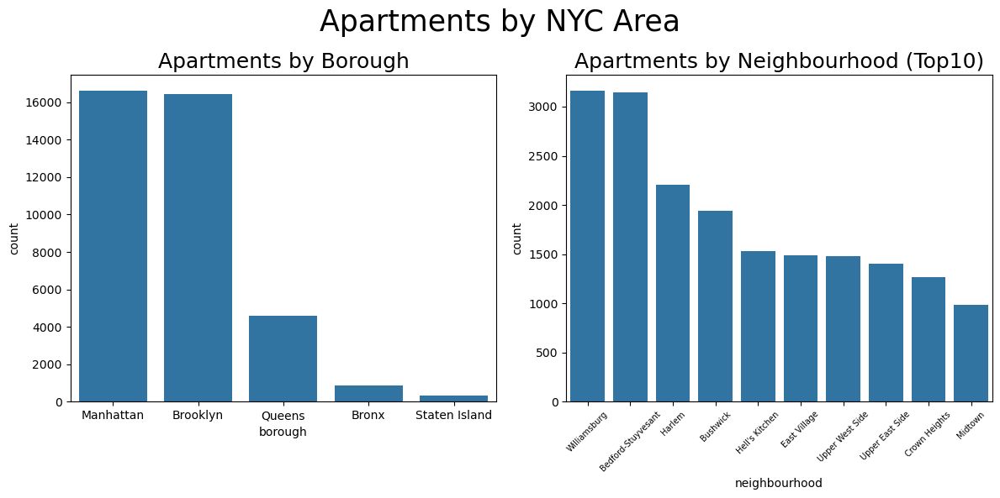

In [44]:
#################################
neighbourhood_group = data2.groupby('borough')['borough'].count().reset_index(name='count').sort_values('count',ascending=False)

neighbourhood = data2.groupby('neighbourhood')['neighbourhood'].count().reset_index(name='count').sort_values('count',ascending=False)
#################################

fig,(ax1,ax2) = plt.subplots(ncols=2,figsize=(12,6))

ax1 = sns.barplot(data=neighbourhood_group,x='borough',y='count',ax=ax1)
ax1.set_title('Apartments by Borough',size=18)

ax2 = sns.barplot(data=neighbourhood.head(10),x='neighbourhood',y='count',ax=ax2)
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=45,fontsize=7)
ax2.set_title('Apartments by Neighbourhood (Top10)',size=18)

plt.suptitle('Apartments by NYC Area',size=25)

plt.tight_layout()

In [46]:
gpd.GeoDataFrame(
    data2,geometry=gpd.points_from_xy(data2["longitude"],data2["latitude"]),crs="epsg:4386"
).explore(width=1000,height=600,name="correct")

## Regiões mais Caras e Ecônomicas

<Figure size 1200x600 with 0 Axes>

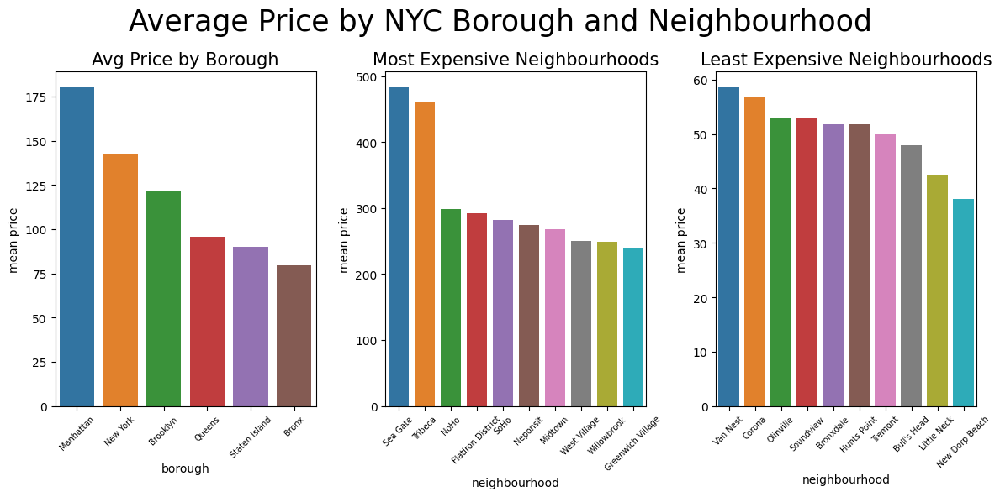

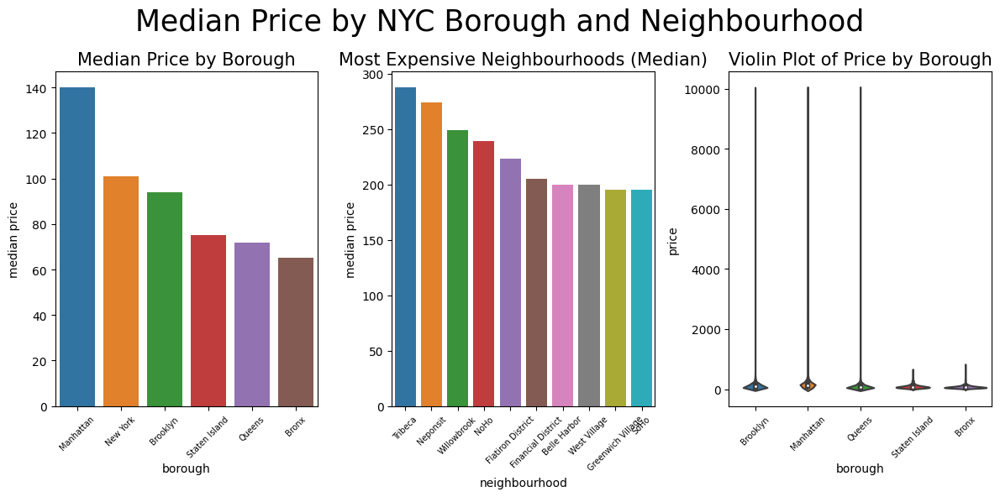

In [73]:
#################################
avg_price_borough = data2.groupby('borough')['price'].mean().reset_index(name='mean price')
new_row = {'borough':'New York','mean price':data2['price'].mean()} 
avg_price_borough = avg_price_borough._append(new_row,ignore_index=True).sort_values('mean price',ascending=False)

median_price_borough = data2.groupby('borough')['price'].median().reset_index(name='median price')
new_row = {'borough':'New York','median price':data2['price'].median()} 
median_price_borough = median_price_borough._append(new_row,ignore_index=True).sort_values('median price',ascending=False)

avg_price_neighbourhood = data2.groupby('neighbourhood')['price'].mean().reset_index(name='mean price').sort_values('mean price',ascending=False)

median_price_neighbourhood = data2.groupby('neighbourhood')['price'].median().reset_index(name='median price').sort_values('median price',ascending=False)
#################################

bigfig = plt.figure(figsize=(12,6))

(top,bottom) = bigfig.subfigures(2,1)

### Top figures ###
top.subplots_adjust(left=.1,right=.9,wspace=.4,hspace=.4)

fig,(ax1,ax2,ax3) = plt.subplots(ncols=3,figsize=(12,6))

ax1 = sns.barplot(data=avg_price_borough,x='borough',y='mean price',ax=ax1)
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=45,fontsize=7)
ax1.set_title('Avg Price by Borough',size=15)

ax2 = sns.barplot(data=avg_price_neighbourhood.head(10),x='neighbourhood',y='mean price',ax=ax2)
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=45,fontsize=7)
ax2.set_title('Most Expensive Neighbourhoods',size=15)

ax3 = sns.barplot(data=avg_price_neighbourhood.tail(10),x='neighbourhood',y='mean price',ax=ax3)
ax3.set_xticklabels(ax3.get_xticklabels(),rotation=45,fontsize=7)
ax3.set_title('Least Expensive Neighbourhoods',size=15)

plt.suptitle('Average Price by NYC Borough and Neighbourhood',size=25)

plt.tight_layout()

### Bottom figures ###
bottom.subplots_adjust(left=.1,right=.9,wspace=.4,hspace=.4)

fig,(ax1,ax2,ax3) = plt.subplots(ncols=3,figsize=(12,6))

ax1 = sns.barplot(data=median_price_borough,x='borough',y='median price',ax=ax1)
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=45,fontsize=7)
ax1.set_title('Median Price by Borough',size=15)

ax2 = sns.barplot(data=median_price_neighbourhood.head(10),x='neighbourhood',y='median price',ax=ax2)
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=45,fontsize=7)
ax2.set_title('Most Expensive Neighbourhoods (Median)',size=15)

ax3 = sns.violinplot(data=data2,x='borough',y='price',ax=ax3)
ax3.set_xticklabels(ax3.get_xticklabels(),rotation=45,fontsize=7)
ax3.set_title('Violin Plot of Price by Borough',size=15)

plt.suptitle('Median Price by NYC Borough and Neighbourhood',size=25)

plt.tight_layout()

Legendando os Histogramas apresentados:
* Manhattan possui o custo mais alto para um locatário iniciar sua renda alternativa na região de Nova York
* A diferença entre o preço médio entre o aluguel da região mais cara e mais barata é menos que a metade entre eles.
* A mediana de preço da mais cara chega a quase $300,00 e a mais barata $60,00. Demonstrando que metade dos apartamentos mais caros estão acima de $300,00 e metade abaixo. Demonstrando que, entre as locações mais baratas, metade exata dos valores transitam entre $60,00. 

## 2.3 Room Types

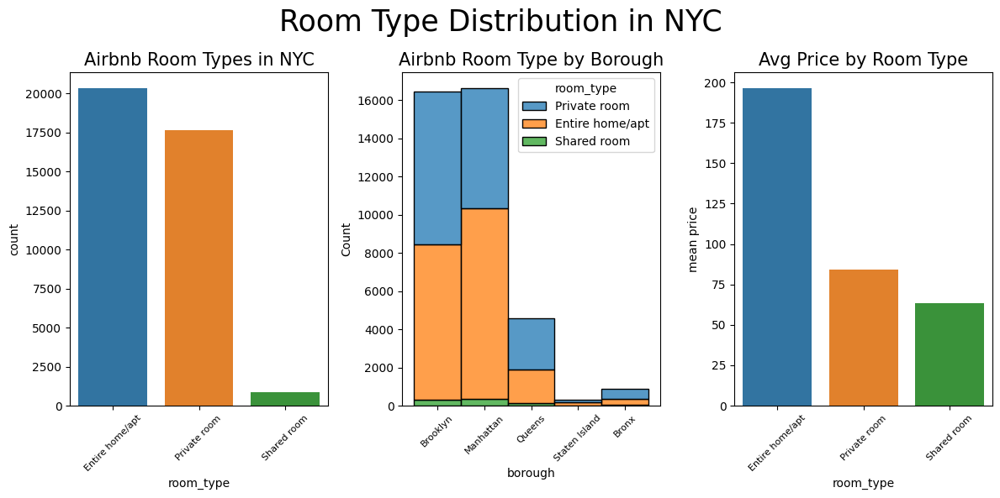

In [74]:
################################
room_type = data2.groupby('room_type')['room_type'].count().reset_index(name='count').sort_values('count',ascending=False)

room_type_borough = data2.groupby(['room_type','borough'])['room_type'].count().reset_index(name='count').sort_values('count',ascending=False)

room_type_price = data2.groupby('room_type')['price'].mean().reset_index(name='mean price').sort_values('mean price',ascending=False)
################################

fig,(ax1,ax2,ax3) = plt.subplots(ncols=3,figsize=(12,6))

ax1 = sns.barplot(data=room_type,x='room_type',y='count',ax=ax1)
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=45,fontsize=8)
ax1.set_title('Airbnb Room Types in NYC',size=15)

ax2 = sns.histplot(data=data2,x='borough',hue='room_type',multiple='stack',ax=ax2)
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=45,fontsize=8)
ax2.set_title('Airbnb Room Type by Borough',size=15)

ax3 = sns.barplot(data=room_type_price,x='room_type',y='mean price',ax=ax3)
ax3.set_xticklabels(ax3.get_xticklabels(),rotation=45,fontsize=8)
ax3.set_title('Avg Price by Room Type',size=15)

plt.suptitle('Room Type Distribution in NYC',size=25)

plt.tight_layout()

In [ ]:
Insights sobre o espaço arquitetônico:
* O espaço arquitetônico mais procurado são casas e apartamentos. 
* Quartos privativos são a segunda opção entre eles.
* O preço médio pelo espaço espaço arquitetônico mais ampliando chega a $200,00, os valores dos quartos privativos e compartilhados contabilizam metade desse valor. 

## 2.4 Minimum Nights

Minimum nights is an important indicator. If it is high, it means that the property is used for a long time, which is a good sign from a customer point of view.

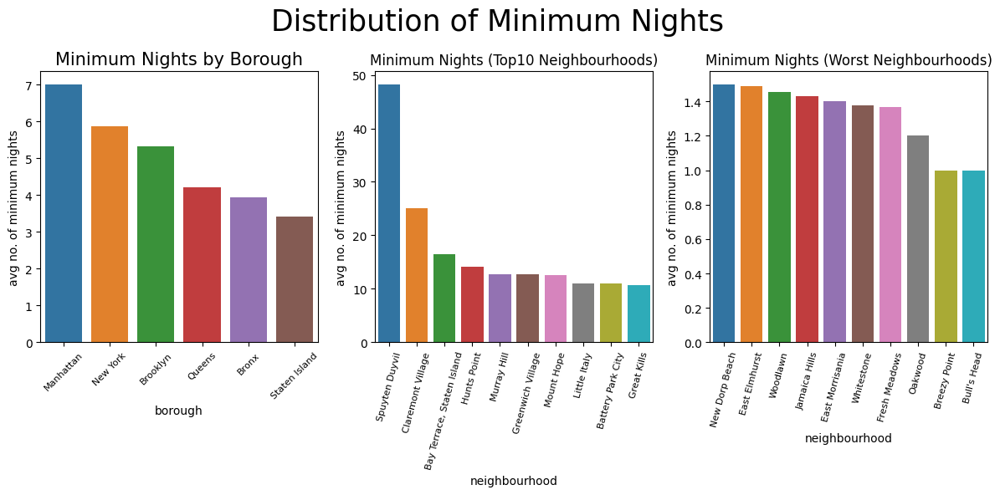

In [75]:
#######################################
minimum_nights_borough = data2.groupby('borough')['minimum_nights'].mean().reset_index(name='avg no. of minimum nights')
new_row = {'borough':'New York','avg no. of minimum nights':data2['minimum_nights'].mean()} 
minimum_nights_borough = minimum_nights_borough._append(new_row,ignore_index=True).sort_values('avg no. of minimum nights',ascending=False)

minimum_nights_neighbourhood = data2.groupby('neighbourhood')['minimum_nights'].mean().reset_index(name='avg no. of minimum nights').sort_values('avg no. of minimum nights',ascending=False)
#######################################

fig,(ax1,ax2,ax3) = plt.subplots(ncols=3,figsize=(12,6))

ax1 = sns.barplot(data=minimum_nights_borough,x='borough',y='avg no. of minimum nights',ax=ax1)
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=45,fontsize=8)
ax1.set_title('Minimum Nights by Borough',size=15)

ax2 = sns.barplot(data=minimum_nights_neighbourhood.head(10),x='neighbourhood',y='avg no. of minimum nights',ax=ax2)
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=75,fontsize=8)
ax2.set_title('Minimum Nights (Top10 Neighbourhoods)',size=12)

ax3 = sns.barplot(data=minimum_nights_neighbourhood.tail(10),x='neighbourhood',y='avg no. of minimum nights',ax=ax3)
ax3.set_xticklabels(ax3.get_xticklabels(),rotation=75,fontsize=8)
ax3.set_title('Minimum Nights (Worst Neighbourhoods)',size=12)

plt.suptitle('Distribution of Minimum Nights',size=25)

plt.tight_layout()

Os dias de locamento nos informam sobre o comportamental preferencial do consumidor:
* Os locatários costumam alugar os espaços disponíveis em Manhattan por no mínimo uma semana. 
* A região de Staten Island foi a menos procurada, apresentando uma média de até 4 noite alugadas por locador. 

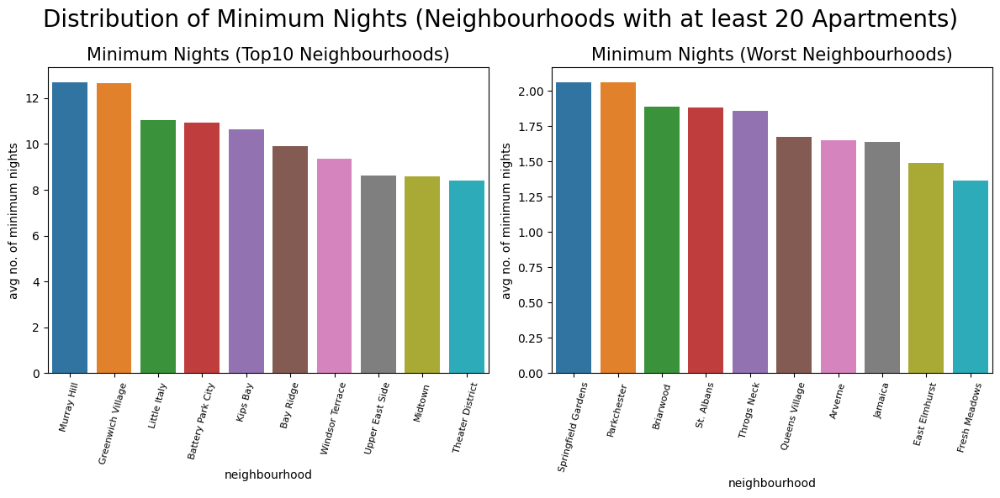

In [78]:
#################################
neighbourhood_list = neighbourhood.loc[neighbourhood['count'] > 20]['neighbourhood'].to_list()

minimum_nights_neighbourhood2 = data2.loc[data2.neighbourhood.isin(neighbourhood_list)].groupby('neighbourhood')['minimum_nights'].mean().reset_index(name='avg no. of minimum nights').sort_values('avg no. of minimum nights',ascending=False)
#################################

fig,(ax1,ax2) = plt.subplots(ncols=2,figsize=(12,6))

ax1 = sns.barplot(data=minimum_nights_neighbourhood2.head(10),x='neighbourhood',y='avg no. of minimum nights',ax=ax1)
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=75,fontsize=8)
ax1.set_title('Minimum Nights (Top10 Neighbourhoods)',size=15)

ax2 = sns.barplot(data=minimum_nights_neighbourhood2.tail(10),x='neighbourhood',y='avg no. of minimum nights',ax=ax2)
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=75,fontsize=8)
ax2.set_title('Minimum Nights (Worst Neighbourhoods)',size=15)

plt.suptitle('Distribution of Minimum Nights (Neighbourhoods with at least 20 Apartments)',size=20)

plt.tight_layout()

* O número mínimo de noites locadas entre os 10 bairros procurados, nos concedem incidência de 12 dias entre elas.
* O mínimo de noite entre os bairros menos procurados também apresenta dois números similares, com dois 2 dias nos dois bairros.

In [68]:
data2.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

In [82]:
df = data2.copy()
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
5,5099,Large Cozy 1 BR Apartment In Midtown East,7322,Chris,Manhattan,Murray Hill,40.74767,-73.97500,Entire home/apt,200,3,74,2019-06-22,0.59,1,129


In [84]:
df.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

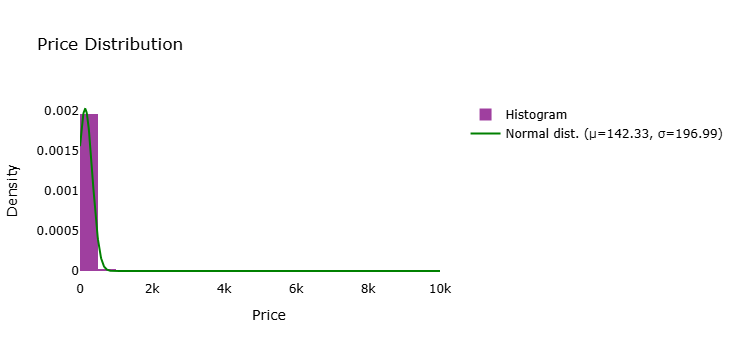

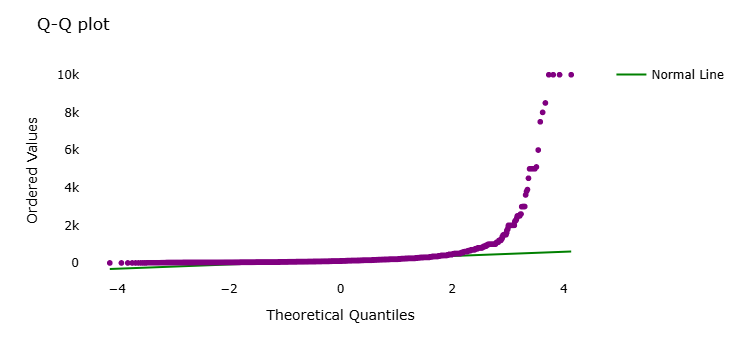

In [119]:
import pandas as pd
import scipy.stats as stats
import plotly.graph_objects as go

# Encaixando uma distribuição normal no Preço dos aluguéis
mu, sigma = stats.norm.fit(df['price'])

# Criando os Histrogramas
hist_data = go.Histogram(
    x=df['price'], 
    nbinsx=50, 
    name="Histogram", 
    opacity=0.75, 
    histnorm='probability density', 
    marker=dict(color='purple')
)

# Criando a curva de distribuição normal
x_norm = np.linspace(df['price'].min(), df['price'].max(), 1000)
y_norm = stats.norm.pdf(x_norm, mu, sigma)
norm_data = go.Scatter(
    x=x_norm, 
    y=y_norm, 
    mode="lines", 
    name=f"Normal dist. (μ={mu:.2f}, σ={sigma:.2f})", 
    line=dict(color="green")
)


fig = go.Figure(data=[hist_data, norm_data])

fig.update_layout(
    title="Price Distribution",
    xaxis_title="Price",
    yaxis_title="Density",
    template="plotly",  # ou simplesmente remova esta linha
    font=dict(color='black'),  # Texto em preto para fundo claro
    plot_bgcolor='white',  # Fundo do gráfico
    paper_bgcolor='white'  # Fundo do papel
)


# Criando a Q-Q plot
qq_data = stats.probplot(df['price'], dist="norm")
qq_fig = px.scatter(x=qq_data[0][0], y=qq_data[0][1], labels={'x': 'Theoretical Quantiles', 'y': 'Ordered Values'}, color_discrete_sequence=["purple"])
qq_fig.update_layout(
    title="Q-Q plot",
    plot_bgcolor='rgba(32, 32, 32, 1)',
    paper_bgcolor='rgba(32, 32, 32, 1)',
    font=dict(color='white')
)

# Ajustando o melhor encaixe para a linha
slope, intercept, r_value, p_value, std_err = stats.linregress(qq_data[0][0], qq_data[0][1])
line_x = np.array(qq_data[0][0])
line_y = intercept + slope * line_x

# Adicionando a linha para melhor the Q-Q plot
line_data = go.Scatter(x=line_x, y=line_y, mode="lines", name="Normal Line", line=dict(color="green"))

# Atualizando the Q-Q plot with the normal line
qq_fig.add_trace(line_data)


qq_fig.update_layout(
    title="Q-Q plot",
    plot_bgcolor='white',  
    paper_bgcolor='white', 
    font=dict(color='black')
)

# Mostrando a figura
fig.show()
qq_fig.show()


# Avaliações

Sumarizando essa seção do Dataset. 

In [79]:
data2.groupby(['name','neighbourhood'])['number_of_reviews'].count().reset_index(name='count').sort_values('count',ascending=False).head(10)

,name,neighbourhood,count
20859,Loft Suite @ The Box House Hotel,Greenpoint,11
17627,Harlem Gem,Harlem,5
27754,Private room in Williamsburg,Williamsburg,5
36981,West Village Apartment,West Village,5
17948,Hillside Hotel,Jamaica,4
11993,Cozy East Village Apartment,East Village,4
36702,WEST VILLAGE Bohemian flat in neo-Tudor town h...,West Village,4
21433,Luminous Modern Apt Share for Young Professionals,Bedford-Stuyvesant,4
36912,"Welcoming, Clean, Cheap on St Marks",East Village,4
20858,Loft Suite @ Box House Hotel,Greenpoint,4


In [166]:
reviews_per_borough = data2.groupby('borough')['number_of_reviews'].sum().reset_index(name='total review count')

avg_reviews_borough = data2.groupby('borough')['number_of_reviews'].mean().reset_index(name='avg reviews/apartment')

reviews_per_borough = reviews_per_borough.merge(avg_reviews_borough,on='borough').sort_values('avg reviews/apartment',ascending=False)

reviews_per_borough

,borough,total review count,avg reviews/apartment
4,Staten Island,11541,36.754777
3,Queens,156902,34.318023
0,Bronx,28334,32.381714
1,Brooklyn,486174,29.574427
2,Manhattan,454126,27.322423


Com uma incidência nova sobre as avaliações apresentadas, fatores como média do preço e oferta de quartos e apartamentos não incidiram na estimulação do público em compartilhar sua experiência em avaliações após a estadia. 

In [81]:
reviews_per_neighbourhood = data2.groupby('neighbourhood')['number_of_reviews'].sum().reset_index(name='count')

avg_reviews_neighbourhood = data2.groupby('neighbourhood')['number_of_reviews'].mean().reset_index(name='avg reviews/apartment')

reviews_per_neighbourhood = reviews_per_neighbourhood.merge(avg_reviews_neighbourhood,on='neighbourhood').sort_values('count',ascending=False).head(10)

reviews_per_neighbourhood

,neighbourhood,count,avg reviews/apartment
13,Bedford-Stuyvesant,110352,35.132760
212,Williamsburg,85427,27.008220
93,Harlem,75927,34.449637
28,Bushwick,52508,27.038105
94,Hell's Kitchen,49940,32.683246
64,East Village,44642,29.981195
61,East Harlem,36440,38.642630
51,Crown Heights,36408,28.781028
200,Upper West Side,36058,24.330634
199,Upper East Side,31686,22.552313


Os pontos geográficos são fatores determinantes pelas exposição e estimulação de avaliações. 

## Anfritiões

Observamos um fator de investimento e alguns locatários ofertando múltiplos imóveis.  

In [82]:
data2.groupby('host_id')['host_id'].value_counts().reset_index(name='count').sort_values('count',ascending=False).head(10)

,host_id,count
28200,219517861,207
20802,61391963,79
12010,16098958,61
25204,137358866,51
8269,7503643,49
27234,190921808,46
16107,30283594,43
2655,1475015,42
24419,120762452,40
14166,22541573,39


O primeiro anfintrião possui 207 imóveis ofertados para localização. Valor destoante dos apresentados pelos demais locatários do aplicativo. 

In [83]:
apartments_219517861 = data2[data2['host_id'] == 219517861].groupby(['borough','neighbourhood'])['name'].count().reset_index(name='count')

price_219517861 = data2[data2['host_id'] == 219517861].groupby(['borough','neighbourhood'])['price'].mean().reset_index(name='avg price')

apartments_219517861 = apartments_219517861.merge(price_219517861,on='neighbourhood').sort_values('count',ascending=False)

apartments_219517861

,borough_x,neighbourhood,count,borough_y,avg price
0,Manhattan,Financial District,170,Manhattan,279.694118
2,Manhattan,Murray Hill,28,Manhattan,239.142857
3,Manhattan,Theater District,5,Manhattan,193.400000
1,Manhattan,Hell's Kitchen,3,Manhattan,186.333333
4,Manhattan,Upper East Side,1,Manhattan,150.000000


Todos os bens dele estão localizados na região de Manhattan e o valor médio dos 170 móveis ofertados no Financial District ficam $30,00 abaixo da mediana dos preços dos demais imóveis ofertados em Nova York.  

In [84]:
gpd.GeoDataFrame(
    data2[data2['host_id'] == 219517861],geometry=gpd.points_from_xy(data2[data2['host_id'] == 219517861]["longitude"],data2[data2['host_id'] == 219517861]["latitude"]),crs="epsg:4386"
).explore(width=1000,height=600,name="correct")

**Host #2**

Let's have a look at the second owner.

In [85]:
apartments_61391963 = data2[data2['host_id'] == 61391963].groupby(['borough','neighbourhood'])['name'].count().reset_index(name='count')

price_61391963 = data2[data2['host_id'] == 61391963].groupby(['borough','neighbourhood'])['price'].mean().reset_index(name='avg price')
apartments_61391963 = apartments_61391963.merge(price_61391963,on='neighbourhood').sort_values('count',ascending=False)

apartments_61391963

,borough_x,neighbourhood,count,borough_y,avg price
3,Manhattan,Kips Bay,19,Manhattan,145.947368
5,Manhattan,Midtown,15,Manhattan,143.400000
8,Manhattan,Upper East Side,15,Manhattan,131.666667
2,Manhattan,Hell's Kitchen,14,Manhattan,152.500000
1,Manhattan,Greenwich Village,4,Manhattan,156.250000
9,Manhattan,Upper West Side,4,Manhattan,137.500000
4,Manhattan,Little Italy,3,Manhattan,160.666667
6,Manhattan,Murray Hill,3,Manhattan,150.000000
0,Manhattan,Chelsea,1,Manhattan,142.000000
7,Manhattan,Nolita,1,Manhattan,142.000000


O segundo locatário oferta seus imóveis todos em Manhattan, com uma diversidade maior entre os bairros e uma média de preço similiar ao resto dos locatários presente na plataforma. 

In [86]:
gpd.GeoDataFrame(
    data2[data2['host_id'] == 61391963],geometry=gpd.points_from_xy(data2[data2['host_id'] == 61391963]["longitude"],data2[data2['host_id'] == 61391963]["latitude"]),crs="epsg:4386"
).explore(width=1000,height=600,name="correct")

# Outliers 

In [89]:
data2.neighbourhood.nunique(), data2.host_id.nunique()

(218, 30232)

In [90]:
data3 = data2.copy()

data3.drop(['neighbourhood','name','host_id'],axis=1,inplace=True)

data3.head()

,borough,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,Brooklyn,40.64749,-73.97237,Private room,149,1,9,0.21,6,365
1,Manhattan,40.75362,-73.98377,Entire home/apt,225,1,45,0.38,2,355
3,Brooklyn,40.68514,-73.95976,Entire home/apt,89,1,270,4.64,1,194
4,Manhattan,40.79851,-73.94399,Entire home/apt,80,10,9,0.10,1,0
5,Manhattan,40.74767,-73.97500,Entire home/apt,200,3,74,0.59,1,129


Processando os dados quantitativos apresentados

In [91]:
num_features = list(data3.select_dtypes(include=np.number).columns.values)

print(num_features)

['latitude', 'longitude', 'price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']


I am plotting the boxplots with the outliers.

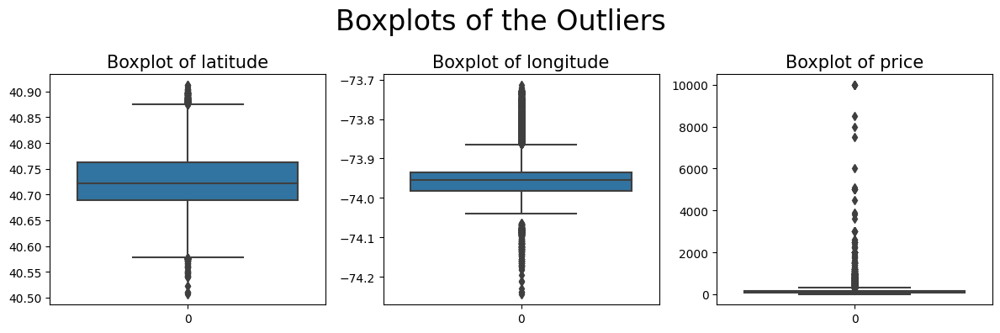

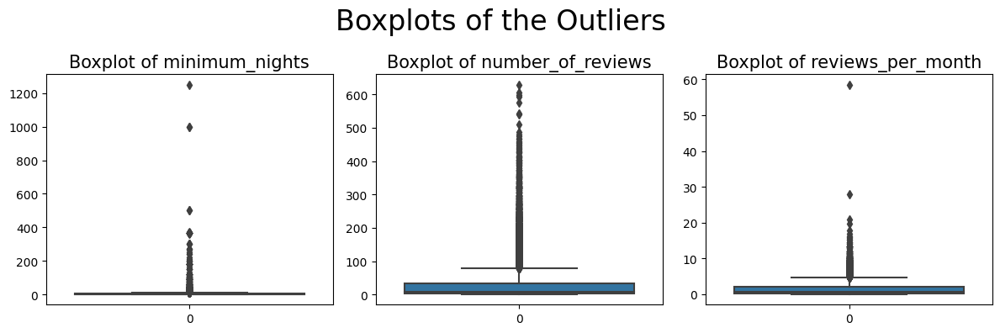

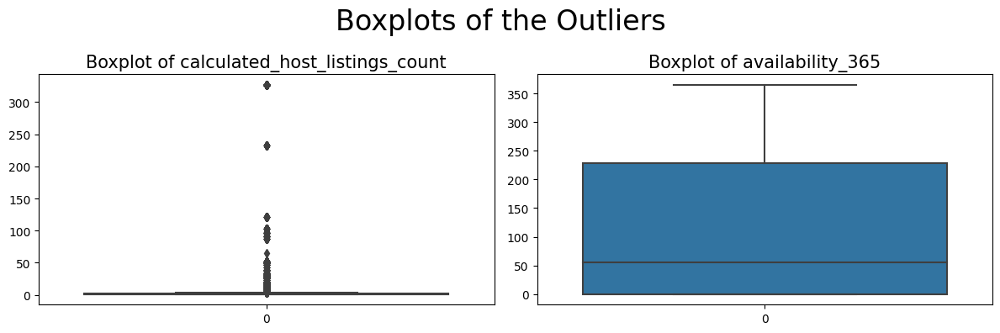

In [92]:
for i in range(3):

    if i < 2:
        fig,(ax1,ax2,ax3) = plt.subplots(ncols=3,figsize=(12,4))
    
        ax1 = sns.boxplot(data3[num_features[i*3]],ax=ax1)
        ax1.set_title(f'Boxplot of {num_features[i*3]}',fontsize=15)
    
        ax2 = sns.boxplot(data3[num_features[i*3+1]],ax=ax2)
        ax2.set_title(f'Boxplot of {num_features[i*3+1]}',fontsize=15)
    
        ax3 = sns.boxplot(data3[num_features[i*3+2]],ax=ax3)
        ax3.set_title(f'Boxplot of {num_features[i*3+2]}',fontsize=15)
    
        fig.suptitle("Boxplots of the Outliers",fontsize=24)    
    
        plt.tight_layout()

    else:

        fig,(ax1,ax2) = plt.subplots(ncols=2,figsize=(12,4))
    
        ax1 = sns.boxplot(data3[num_features[i*3]],ax=ax1)
        ax1.set_title(f'Boxplot of {num_features[i*3]}',fontsize=15)
    
        ax2 = sns.boxplot(data3[num_features[i*3+1]],ax=ax2)
        ax2.set_title(f'Boxplot of {num_features[i*3+1]}',fontsize=15)
    
        fig.suptitle("Boxplots of the Outliers",fontsize=24)    
    
        plt.tight_layout()

O Standart Deviation de apresenta um comportamento adequado pelo visualizado anteriormente, com poucas incidências de outliers, com excessões sendo raras e situacionais. 

In [93]:
outliers_perc = []

for k,v in data3[num_features].items():
    q1 = v.quantile(0.25)
    q3 = v.quantile(0.75)
    irq = q3 - q1
    v_col = v[(v <= q1 - 1.5 * irq) | (v >= q3 + 1.5 * irq)]
    perc = np.shape(v_col)[0] * 100.0 / np.shape(data)[0]
    out_tuple = (k,int(perc))
    outliers_perc.append(out_tuple)
    print("Column %s outliers = %.2f%%" % (k,perc))

Column latitude outliers = 0.56%
Column longitude outliers = 4.70%
Column price outliers = 4.25%
Column minimum_nights outliers = 9.13%
Column number_of_reviews outliers = 8.80%
Column reviews_per_month outliers = 3.66%
Column calculated_host_listings_count outliers = 10.71%
Column availability_365 outliers = 0.00%


Os Outliers de preço e longitude  apresentando <5% de incidência, significando uma pouca relevancia estatística. 
Os Outliers de noites mínimas similar com o de noites mínimas, pois são valores proporcionais, e neste ponto apresentam mais situações singulares. 

In [94]:
def outlier_capper(data,features):
    
    data_out = data.copy()
    
    for column in features:        
        
        # First define the first and third quartiles
        Q1 = data_out[column].quantile(0.25)
        Q3 = data_out[column].quantile(0.75)
        # Define the inter-quartile range
        IQR = Q3 - Q1
        # ... and the lower/higher threshold values
        lowerL  = Q1 - 1.5 * IQR
        higherL = Q3 + 1.5 * IQR
        
        # Impute 'left' outliers
        data_out.loc[data_out[column] < lowerL,column] = lowerL
        # Impute 'right' outliers
        data_out.loc[data_out[column] > higherL,column] = higherL
        
    return data_out
    

data3 = outlier_capper(data3,num_features) 

# Engenheira de Recursos

Escalando às variaveis numéricas 

In [95]:
# Initialize a scaler, then apply it to the numerical features
scaler = MinMaxScaler()

# List of numerical columns
num_cols = [col for col in data3.columns if data3[col].dtypes != 'O']

# Scale the numerical columns
data3[num_cols] = scaler.fit_transform(data3[num_cols])

In [96]:
data3 = pd.get_dummies(data3)

data3.head()

,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,borough_Bronx,borough_Brooklyn,borough_Manhattan,borough_Queens,borough_Staten Island,room_type_Entire home/apt,room_type_Private room,room_type_Shared room
0,0.236634,0.428172,0.463453,0.000000,0.103896,0.042061,1.0,1.000000,False,True,False,False,False,False,True,False
1,0.593494,0.368097,0.699844,0.000000,0.571429,0.077813,0.4,0.972603,False,False,True,False,False,True,False,False
3,0.363231,0.494625,0.276827,0.000000,1.000000,0.973712,0.0,0.531507,False,True,False,False,False,True,False,False
4,0.744435,0.577730,0.248834,1.000000,0.103896,0.018927,0.0,0.000000,False,False,True,False,False,True,False,False
5,0.573487,0.414313,0.622084,0.266667,0.948052,0.121977,0.0,0.353425,False,False,True,False,False,True,False,False


Now, I can define X and y and then perform the train-test split.

In [97]:
X = data3.drop('price',axis=1)
y = data3['price']

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=42)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((27174, 15), (11647, 15), (27174,), (11647,))

Configurando a Floresta Aleatória com 10 árvores de decisão. 

In [98]:
rf = RandomForestRegressor(n_estimators=20)
rf.fit(X_train,y_train)

RandomForestRegressor(n_estimators=20)

In [99]:
# To sort the index in descending order, I multiply 'rf.feature_importances_' by -1
sorted_idx = (-rf.feature_importances_).argsort()

list_of_tuples = list(zip(X.columns[sorted_idx],
                           rf.feature_importances_[sorted_idx]))

feat_importance = pd.DataFrame(list_of_tuples,
                  columns=['feature','feature importance'])

feat_importance

,feature,feature importance
0,room_type_Entire home/apt,0.362601
1,longitude,0.177824
2,latitude,0.151951
3,availability_365,0.091708
4,reviews_per_month,0.080484
5,number_of_reviews,0.057948
6,minimum_nights,0.048116
7,calculated_host_listings_count,0.019240
8,borough_Manhattan,0.003628
9,room_type_Private room,0.001988


One can easily check that the resulting feature importances are normalized to one.

In [100]:
sum = 0

for index,row in feat_importance.iterrows():
    sum += row['feature importance']

sum

0.9999999999999998

In [101]:
perm_importance = permutation_importance(rf,X_train,y_train)

sorted_idx = (-perm_importance.importances_mean).argsort()

list_of_tuples  = list(zip(X.columns[sorted_idx],
                           perm_importance.importances_mean[sorted_idx]))

perm_importance = pd.DataFrame(list_of_tuples,
                  columns=['feature','permutation importance'])

perm_importance

,feature,permutation importance
0,room_type_Entire home/apt,0.865687
1,longitude,0.569114
2,latitude,0.417072
3,availability_365,0.380248
4,reviews_per_month,0.173710
5,minimum_nights,0.171292
6,number_of_reviews,0.159369
7,calculated_host_listings_count,0.073666
8,room_type_Private room,0.009061
9,borough_Manhattan,0.008909


Diferentemente do caso anterior, as importâncias por permutação não são normalizadas para 1.

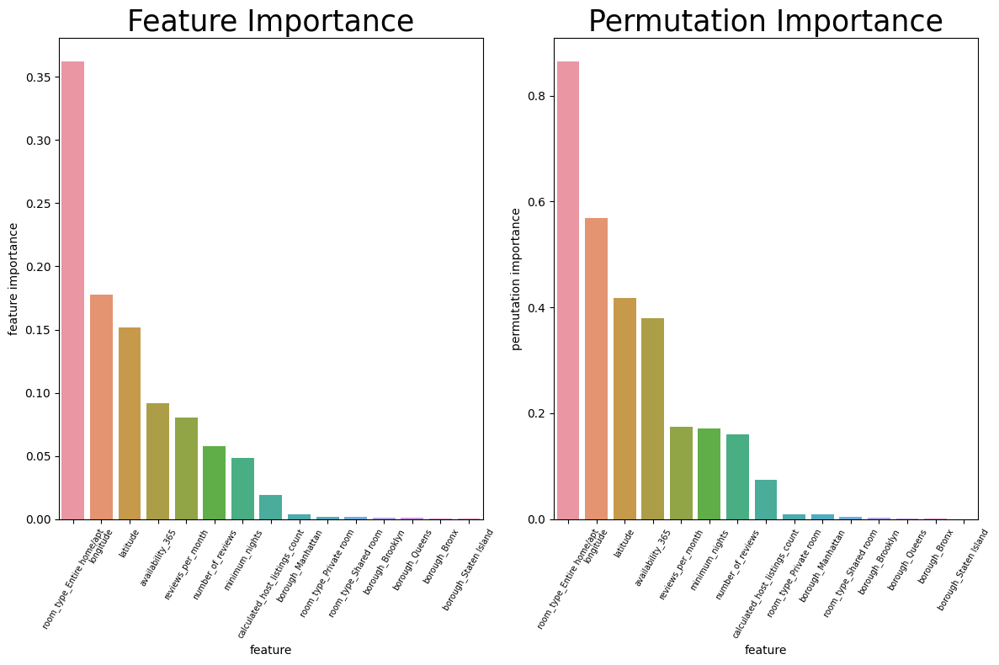

In [102]:
fig,(ax1,ax2) = plt.subplots(ncols=2,figsize=(12,8))

ax1 = sns.barplot(data=feat_importance,x='feature',y='feature importance',ax=ax1)
ax1.set_title('Feature Importance',fontsize=25)
ax1.set_xticklabels(ax1.get_xticklabels(),rotation=60,fontsize=7)

ax2 = sns.barplot(data=perm_importance,x='feature',y='permutation importance',ax=ax2)
ax2.set_title('Permutation Importance',fontsize=25)
ax2.set_xticklabels(ax2.get_xticklabels(),rotation=60,fontsize=7)
    
plt.tight_layout()

Os dois métodos preditivos seguiram o mesmo método de aprendizado e apresentaram uma proposta similar.

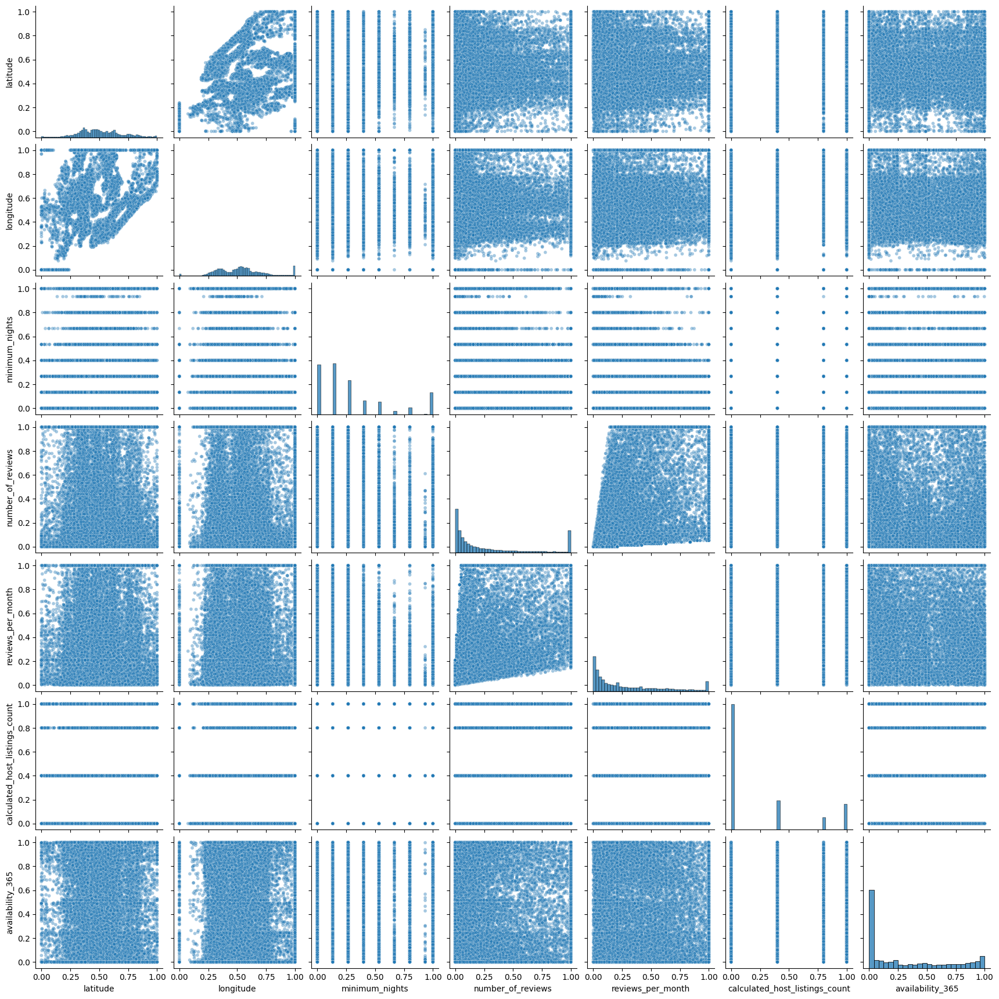

In [103]:
collin_check_list = ['latitude','longitude','minimum_nights', 
                     'number_of_reviews','reviews_per_month',
                     'calculated_host_listings_count',
                     'availability_365']

sns.pairplot(X_train[collin_check_list],plot_kws={'alpha':0.4,'size':5})

Não é apresentado uma colinearidade que possa afetar a regressão dos resultados. 

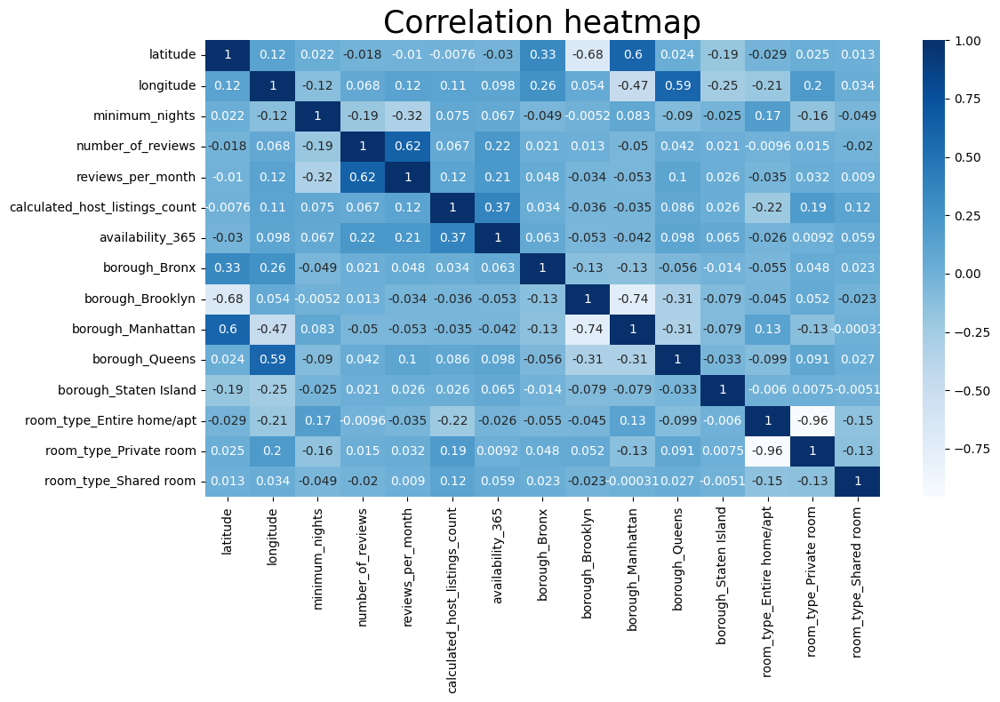

In [104]:
# Create correlation heatmap
plt.figure(figsize=(12,8))
sns.heatmap(X_train.corr(method='pearson'),annot=True,cmap='Blues')
plt.title('Correlation heatmap',fontsize=25)

plt.tight_layout()
plt.show()

* Cerca de 13% dos imóveis alugados em Manhattan são uma Casa ou um Apartamento inteiro.
* Dentre os locadores da plataforma, 17% deles passam as noites mínimas em Staten Island.
* Dentre os locatários da plataforma, 19% deles ofertam quartos privativos e 12% quartos compartilhados. 

In [105]:
len(data2.room_type)

38821

In [106]:
data2.room_type.value_counts()

room_type
Entire home/apt    20321
Private room       17654
Shared room          846
Name: count, dtype: int64

As casas e os quartos privativos apresentam números inversamente proporcionais, sendo 98% de correlação negativa. 
Os quartos compartilhados representam os 2% restante do montante de  imóveis

# Construção do Modelo Preditivo

In [107]:
def train_predict(learner,sample_size,X_train,y_train,X_test,y_test): 
    '''
    inputs:
       - learner: the learning algorithm to be trained and predicted on
       - sample_size: the size of samples (number) to be drawn from training set
       - X_train: features training set
       - y_train: income training set
       - X_test: features testing set
       - y_test: income testing set
    '''
    
    results = {}

    # Fit the learner to the training data using slicing with 'sample_size'
    start = time() # Get start time
    learner = learner.fit(X_train[:sample_size],y_train[:sample_size])
    end = time() # Get end time
    
    # Calculate the training time
    results['train_time'] = end - start
        
    #  Get the predictions on the test set,
    #  then get predictions on the first 300 training samples
    start = time() # Get start time
    predictions_test = learner.predict(X_test)
    predictions_train = learner.predict(X_train[:300])
    end = time() # Get end time

    # Calculate the total prediction time
    results['pred_time'] = end - start
            
    # Compute R^2 score on the first 300 training samples
    results['r2_train'] = r2_score(y_train[:300],predictions_train)
        
    # Compute R^2 score on test set
    results['r2_test'] = r2_score(y_test,predictions_test)
    
    # Compute MSE on the the first 300 training samples
    results['mse_train'] = mean_squared_error(y_train[:300],predictions_train)
        
    # Compute F-score on the test set
    results['mse_test'] = mean_squared_error(y_test,predictions_test)
       
    # Success
    print("{} trained on {} samples.".format(learner.__class__.__name__,sample_size))
        
    # Return the results
    return results

In [108]:
# Initialize the three models
reg_A = RandomForestRegressor(random_state=42)
reg_B = GradientBoostingRegressor(random_state=42)
reg_C = DecisionTreeRegressor(random_state=42)

# Calculate the number of samples for 1%, 10%, and 100% of the training data
samples_1   = int(round(len(X_train) / 100))
samples_10  = int(round(len(X_train) / 10))
samples_100 = len(X_train)

# Collect results on the learners
results = {}
for reg in [reg_A,reg_B,reg_C]:
    reg_name = reg.__class__.__name__
    results[reg_name] = {}
    for i,samples in enumerate([samples_1,samples_10,samples_100]):
        results[reg_name][i] = \
        train_predict(reg,samples,X_train,y_train,X_test,y_test)

RandomForestRegressor trained on 272 samples.
RandomForestRegressor trained on 2717 samples.
RandomForestRegressor trained on 27174 samples.
GradientBoostingRegressor trained on 272 samples.
GradientBoostingRegressor trained on 2717 samples.
GradientBoostingRegressor trained on 27174 samples.
DecisionTreeRegressor trained on 272 samples.
DecisionTreeRegressor trained on 2717 samples.
DecisionTreeRegressor trained on 27174 samples.


In [109]:
# Printing out the values
for i in results.items():
    print(i[0])
    display(pd.DataFrame(i[1]).rename(columns={0:'1%',1:'10%',2:'100%'}))

RandomForestRegressor


,1%,10%,100%
train_time,0.208512,1.344793,15.647902
pred_time,0.103071,0.185715,0.415719
r2_train,0.886756,0.939181,0.938238
r2_test,0.459845,0.525830,0.575098
mse_train,0.006693,0.003595,0.003650
mse_test,0.032100,0.028179,0.025251


GradientBoostingRegressor


,1%,10%,100%
train_time,0.086814,0.467121,4.118709
pred_time,0.025147,0.025771,0.027025
r2_train,0.882497,0.650082,0.599967
r2_test,0.437570,0.543301,0.564104
mse_train,0.006945,0.020682,0.023644
mse_test,0.033424,0.027141,0.025904


DecisionTreeRegressor


,1%,10%,100%
train_time,0.004500,0.020542,2.325718e-01
pred_time,0.004182,0.005611,8.218765e-03
r2_train,0.912062,1.000000,1.000000e+00
r2_test,0.097756,0.102462,1.622498e-01
mse_train,0.005198,0.000000,1.412349e-35
mse_test,0.053619,0.053339,4.978575e-02


Prosseguindo com o refinamento da Floresta Aleatória. 

In [110]:
random_forest_tuning = RandomForestRegressor(random_state=42)

param_grid = {
    'n_estimators': [100,200,300,400],
    'max_depth': [None,5,10]
}

GSCV = GridSearchCV(estimator=random_forest_tuning,param_grid=param_grid,cv=5)
GSCV.fit(X_train,y_train)

GSCV.best_params_ 

{'max_depth': 10, 'n_estimators': 200}

**Model performance on the train data**

In [111]:
r_sq = GSCV.score(X_train,y_train)
y_pred_train = GSCV.predict(X_train)

print('R^2:',r2_score(y_train,y_pred_train))

R^2: 0.6668128510126868


**Model performance on the test data**

In [112]:
r_sq_test = GSCV.score(X_test,y_test)
y_pred_test = GSCV.predict(X_test)

print('R^2:',r2_score(y_test,y_pred_test))

R^2: 0.5803077917184416


O segundo modelo preditivo apresentou um coeficiente de determinação de  0,6668. Indicando um ajuste bom, porém passível de melhorias. 
Onde, 33,32% da variabilidade sobre a variância não é explicada. Indicando assim, a importância de investigações mais específicas para introdução de variaveis mais significativas. o problema.

# Recomendações

Através desta análise observamos alguns pontos pertinentes para variabilidade e apresentação dos preços, sendo um deles, impacto sazonal dos feriados e datas comemorativas. 
Esse período do ano impactaria os imóveis mais alugados como Apartamentos e Casas, já que podem confortar famílias e grupos numerosos. Ocasionando um impacto nos preços estipulados por seus anfitriões.

Uma correlação positiva encontrada no dataset foi a longitude e sua procura por hospedagem prévias, sendo elas, um cómodo em um ponto estrátegico com aeroportos, e instituições subtâncias de emergências para população com estadia passageira. Salientando assim, que mesmo em um bairro com pouca demanda, a comodidade de localização pode impactar no preço ofertado. 

Com uma média de preço por noite de $152,00 e uma mediana de $300,00. E um Standart Deviation dos preço em $159,00. Os testes estatísticos e resultados apresentados observam esse valor médio referenciado, para uma margem de erro mais cara de $ 182,95 e um RMSE de teste de 142,72. 

Lugares como Manhattan possui o custo mais alto para um locatário iniciar sua renda alternativa na região de Nova York.  A diferença entre o preço médio entre o aluguel da região mais cara e mais barata é menos que a metade entre eles.
* A mediana de preço da mais cara chega a quase $300,00 e a mais barata $60,00. Demonstrando que metade dos apartamentos mais caros estão acima de $300,00 e metade abaixo. Demonstrando que, entre as locações mais baratas, metade exata dos valores transitam entre $60,00.
Insights sobre o espaço arquitetônic

* O espaço arquitetônico mais procurado são casas e apartament  
* Quartos privativos são a segunda opção entre  s.
* O preço médio pelo espaço espaço arquitetônico mais ampliando chega a $200,00, os valores dos quartos privativos e compartilhados contabilizam metade desse v
dor:
* Os locatários costumam alugar os espaços disponíveis em Manhattan por no mínimo uma ana. 
* A região de Staten Island foi a menos procurada, apresentando uma média de até 4 noite alugadas por locador.
A compra de um imóvel mais indicada é em Manhattan. O número mínimo de noites e sua disponibilidade ao longo do ano apresentaram uma correlação positiva de 17% em Staten Island, interferindo assim positivamente em seu preço.
